In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os

#for dirname, _, filenames in os.walk('/kaggle/input'):
    #for filename in filenames:
        #print(os.path.join(dirname, filename))

# You can write up to 5GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import json

with open("../input/til2020/train.json",'r') as file:
    train_data = json.load(file)
    
with open("../input/til2020/val.json",'r') as file:
    test_data = json.load(file)
    
print("%.1000s" % train_data)

{'annotations': [{'area': 2304645, 'iscrowd': 0, 'id': 1, 'image_id': 10, 'category_id': 4, 'bbox': [704, 620, 1401, 1645]}, {'area': 55769, 'iscrowd': 0, 'id': 2, 'image_id': 1000, 'category_id': 1, 'bbox': [321, 332, 217, 257]}, {'area': 17108, 'iscrowd': 0, 'id': 3, 'image_id': 10003, 'category_id': 2, 'bbox': [220, 758, 188, 91]}, {'area': 117909, 'iscrowd': 0, 'id': 4, 'image_id': 10003, 'category_id': 5, 'bbox': [150, 397, 297, 397]}, {'area': 105925, 'iscrowd': 0, 'id': 5, 'image_id': 10003, 'category_id': 1, 'bbox': [85, 207, 475, 223]}, {'area': 3314505, 'iscrowd': 0, 'id': 6, 'image_id': 10005, 'category_id': 4, 'bbox': [1971, 2059, 1483, 2235]}, {'area': 198360, 'iscrowd': 0, 'id': 7, 'image_id': 10005, 'category_id': 2, 'bbox': [1524, 3739, 380, 522]}, {'area': 922870, 'iscrowd': 0, 'id': 8, 'image_id': 10005, 'category_id': 4, 'bbox': [1280, 2736, 806, 1145]}, {'area': 708070, 'iscrowd': 0, 'id': 9, 'image_id': 10005, 'category_id': 2, 'bbox': [408, 3708, 785, 902]}, {'are

In [3]:
train_annotations = train_data['annotations']
train_images = train_data['images']
categories = train_data['categories']

print(train_annotations[0])
print(train_images[0])
print(categories)

print(len(train_annotations))

{'area': 2304645, 'iscrowd': 0, 'id': 1, 'image_id': 10, 'category_id': 4, 'bbox': [704, 620, 1401, 1645]}
{'file_name': '10.jpg', 'id': 10}
[{'id': 1, 'name': 'tops'}, {'id': 2, 'name': 'trousers'}, {'id': 3, 'name': 'outerwear'}, {'id': 4, 'name': 'dresses'}, {'id': 5, 'name': 'skirts'}]
13317


In [4]:
test_annotations = test_data['annotations']
test_images = test_data['images']

print(test_annotations[0])
print(test_images[0])

print(len(test_annotations))

{'area': 996743, 'iscrowd': 0, 'id': 1, 'image_id': 1, 'category_id': 4, 'bbox': [523, 55, 869, 1147]}
{'file_name': '1.jpg', 'id': 1}
2458


# Build a dictionary for categories

In [5]:
category_mapping = {}

for category_item in categories:
    category_mapping[category_item['id']] = category_item['name']



# Let's add image path in annotations

In [6]:
train_id_to_path_mapping = {}

for image_item in train_images:
    train_id_to_path_mapping[image_item['id']] = image_item['file_name']
    
test_id_to_path_mapping = {}

for image_item in test_images:
    test_id_to_path_mapping[image_item['id']] = image_item['file_name']
    
for annotation in train_annotations:
    annotation['image_path'] = train_id_to_path_mapping[annotation['image_id']]
    annotation['cat'] = category_mapping[annotation['category_id']]
    annotation['bbox'] = list(map(int,annotation['bbox']))
    
for annotation in test_annotations:
    annotation['image_path'] = test_id_to_path_mapping[annotation['image_id']]
    annotation['cat'] = category_mapping[annotation['category_id']]
    annotation['bbox'] = list(map(int,annotation['bbox']))
    
print("%.1000s" % train_annotations)
print("%.1000s" % test_annotations)

[{'area': 2304645, 'iscrowd': 0, 'id': 1, 'image_id': 10, 'category_id': 4, 'bbox': [704, 620, 1401, 1645], 'image_path': '10.jpg', 'cat': 'dresses'}, {'area': 55769, 'iscrowd': 0, 'id': 2, 'image_id': 1000, 'category_id': 1, 'bbox': [321, 332, 217, 257], 'image_path': '1000.jpg', 'cat': 'tops'}, {'area': 17108, 'iscrowd': 0, 'id': 3, 'image_id': 10003, 'category_id': 2, 'bbox': [220, 758, 188, 91], 'image_path': '10003.jpg', 'cat': 'trousers'}, {'area': 117909, 'iscrowd': 0, 'id': 4, 'image_id': 10003, 'category_id': 5, 'bbox': [150, 397, 297, 397], 'image_path': '10003.jpg', 'cat': 'skirts'}, {'area': 105925, 'iscrowd': 0, 'id': 5, 'image_id': 10003, 'category_id': 1, 'bbox': [85, 207, 475, 223], 'image_path': '10003.jpg', 'cat': 'tops'}, {'area': 3314505, 'iscrowd': 0, 'id': 6, 'image_id': 10005, 'category_id': 4, 'bbox': [1971, 2059, 1483, 2235], 'image_path': '10005.jpg', 'cat': 'dresses'}, {'area': 198360, 'iscrowd': 0, 'id': 7, 'image_id': 10005, 'category_id': 2, 'bbox': [1524,

# Crop Image

(3264, 2448, 3)


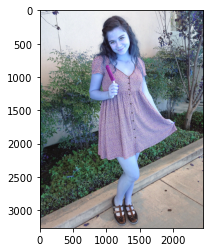

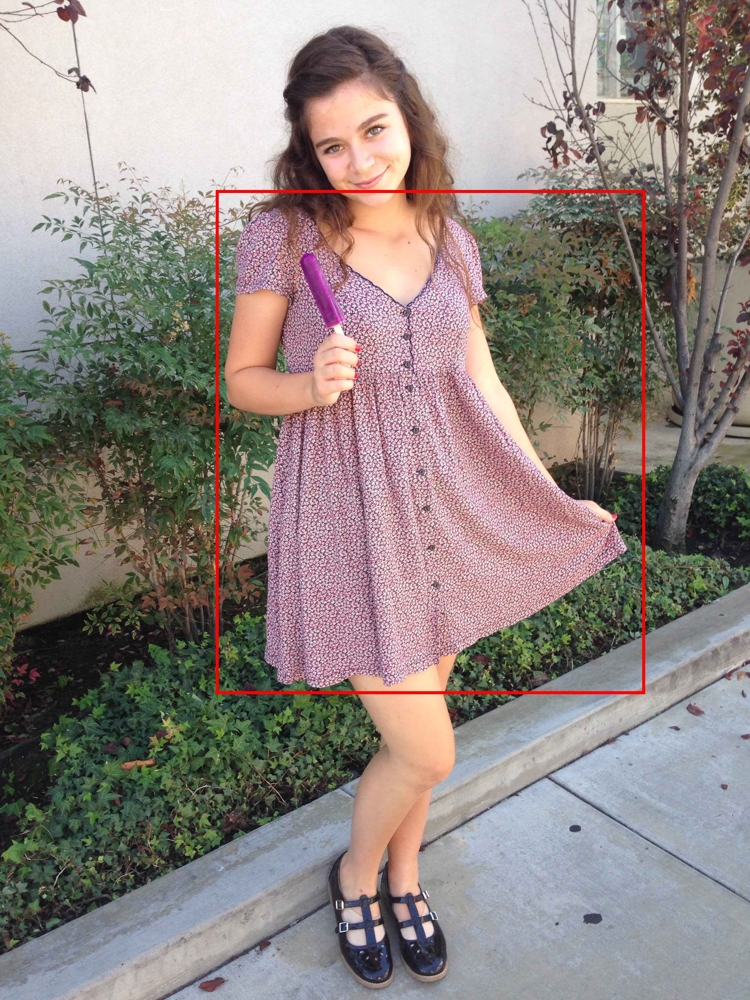

In [7]:
from matplotlib import pyplot as plt
import cv2

base_path = r'../input/til2020/train/train/'

annotation = train_annotations[0]
coordinates = annotation['bbox']

im = cv2.imread(base_path+annotation['image_path'])
#Show the image with matplotlib
print(im.shape)
plt.imshow(im)
plt.show()

from PIL import Image, ImageFont, ImageDraw

img = Image.open(base_path+annotation['image_path'])
# create rectangle image
img1 = ImageDraw.Draw(img)
img1.rectangle(((coordinates[0], coordinates[1]),(coordinates[0]+coordinates[2], coordinates[1]+coordinates[3])),  outline ="red",width=10)
img1.text((523,25), "dresses", fill=(255,255,255,128))
display(img)


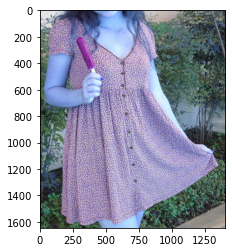

(1645, 1401, 3)


In [8]:
image = im[coordinates[1]:coordinates[1]+coordinates[3],coordinates[0]:coordinates[0]+coordinates[2]]

plt.imshow(image)
plt.show()
print(image.shape)

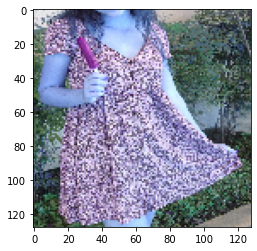

(128, 128, 3)


In [9]:
resized_image = cv2.resize(image, (128, 128),  
               interpolation = cv2.INTER_NEAREST) 

plt.imshow(resized_image)
plt.show()
print(resized_image.shape)

# Visualising 10 Images


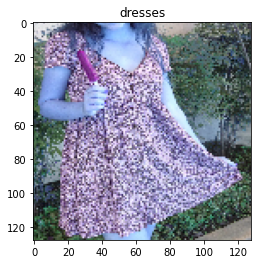

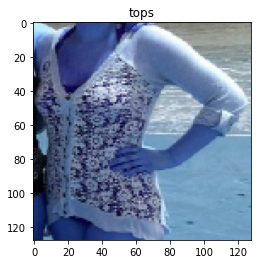

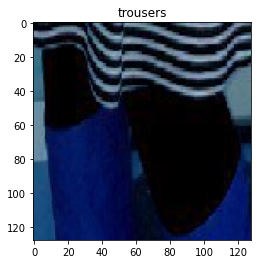

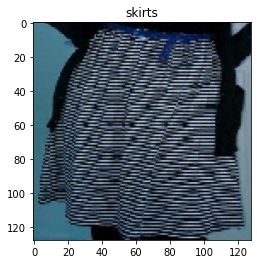

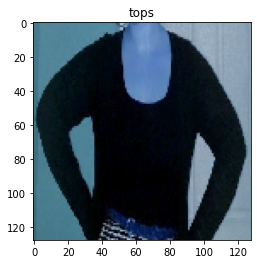

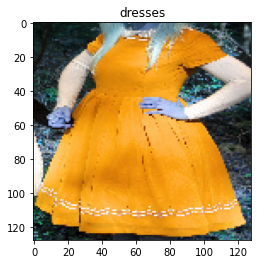

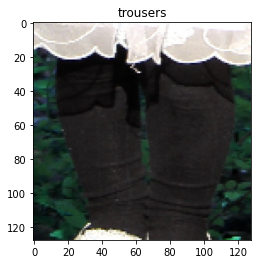

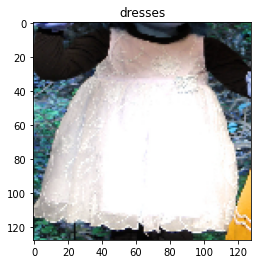

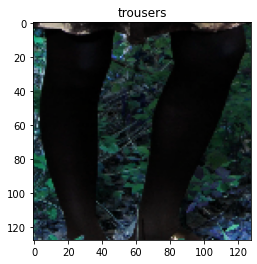

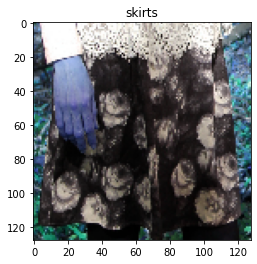

In [10]:
max_images = 10

for annotation in train_annotations[:max_images]:
    coordinates = annotation['bbox']
    
    x = coordinates[0]
    y = coordinates[1]
    width = coordinates[2]
    height = coordinates[3]

    im = cv2.imread(base_path+annotation['image_path'])
    image = im[y:y+height,x:x+width]

    resized_image = cv2.resize(image, (128, 128), interpolation = cv2.INTER_NEAREST) 
    #resized_image = cv2.resize(image, (224, 224), interpolation = cv2.INTER_NEAREST) 
    #resized_image = cv2.resize(image, (64, 64), interpolation = cv2.INTER_NEAREST) 
    plt.imshow(resized_image)
    plt.title(annotation['cat'])
    plt.show()
    #print(annotation['cat'])


# Training a Simple CNN

In [11]:
from matplotlib import pyplot as plt
from PIL import Image, ImageFont, ImageDraw
    
import numpy as np
import cv2
import keras

#, original_shape, new_shape=(224,224)

def get_cropped_image(img, bbox):
    start_x, start_y, width, height = bbox
    cropped_img = img[start_y:start_y+height, start_x:start_x+width]
    return cropped_img
      
def get_reshaped_image(img, new_shape=(224,224)):
    resized_image = cv2.resize(img, new_shape, interpolation = cv2.INTER_NEAREST) 
    return resized_image

def rescale_bbox(bbox, current_img_shape, new_img_shape=(224,224)):
    x_ratio = new_img_shape[0] / current_img_shape[0]
    y_ratio = new_img_shape[1] / current_img_shape[1]
    
    new_x = bbox[0] * x_ratio
    new_y = bbox[1] * y_ratio
    new_width = bbox[2] * x_ratio
    new_height = bbox[3] * y_ratio
    
    return new_x, new_y, new_width, new_height
   

# Temporary Test

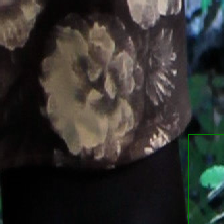

In [12]:
# Temporary Test
max_images = 1
title_distance = 10

for annotation in train_annotations[:max_images]:
    bbox = annotation['bbox']

    img = Image.open(base_path+annotation['image_path'])
    img2 = np.asarray(image)
    
    x,y,w,h = rescale_bbox(bbox, (img2.shape[0],img2.shape[1]))
    cropped_image = get_cropped_image(img2, bbox)
    reshaped_image = get_reshaped_image(cropped_image)

    img = Image.fromarray(reshaped_image)
    img3 = ImageDraw.Draw(img)
    img3.rectangle(((x, y),(x+w, y+h)),  outline ="green",width=1)
    #img3.text((x-title_distance,y-title_distance), "dresses", fill=(255,255,255,128))
    display(img)

In [13]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set_style()

# to divide our data into train and validation set
from sklearn.model_selection import train_test_split
#to encode our labels
from tensorflow.keras.utils import to_categorical
#to build our model 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Conv2D,MaxPool2D,Flatten,Dropout
# Our optimizer options
from keras.optimizers import RMSprop
from keras.optimizers import Adam
#Callback options
from tensorflow.keras.callbacks import EarlyStopping
from keras.callbacks import ReduceLROnPlateau
#importing image data generator for data augmentation
from tensorflow.keras.preprocessing.image import ImageDataGenerator
#for the final prediction report
from sklearn.metrics import classification_report ,confusion_matrix

# Prepare Training Data

In [14]:
new_categories = [x['name'] for x in categories]
print(new_categories)
encoded_categories = to_categorical(list(range(len(new_categories))), num_classes=len(new_categories))
print(encoded_categories)

category_mapping = {x:encoded_categories[i] for i,x in enumerate(new_categories)}
print(category_mapping)

['tops', 'trousers', 'outerwear', 'dresses', 'skirts']
[[1. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 1.]]
{'tops': array([1., 0., 0., 0., 0.], dtype=float32), 'trousers': array([0., 1., 0., 0., 0.], dtype=float32), 'outerwear': array([0., 0., 1., 0., 0.], dtype=float32), 'dresses': array([0., 0., 0., 1., 0.], dtype=float32), 'skirts': array([0., 0., 0., 0., 1.], dtype=float32)}


In [15]:
import cv2
import traceback
import sys

# dresses_count = 0
# trousers_count = 0

def transform_data(annotations, base_dir, samples_per_cat=None, cats=None):
    features = []
    labels = []
    max_check = False
    cat_count = {}
    
    if samples_per_cat is not None:
        max_check = True
        cat_count = {x:0 for x in cats}
    else:
        samples_per_cat = sys.maxsize
        
    
    for i, annotation in enumerate(annotations):
        img_path = annotation['image_path']
        cat = annotation['cat']
        bbox = annotation['bbox']

        try:
            if max_check:
                if cat in cats:
                    if cat_count[cat] >= samples_per_cat:
                        continue
                else:
                    continue

        #     if cat == 'trousers':
        #         trousers_count +=1

        #         if trousers_count > max_img:
        #             continue
        #     elif cat == 'dresses':
        #         dresses_count +=1

        #         if dresses_count > max_img:
        #             continue
        #     else:
        #         continue

            img = cv2.imread(base_dir+img_path)

            if img is None:
                continue
            
            #x,y,w,h = rescale_bbox(bbox, (img.shape[0],img.shape[1]))
            cropped_image = get_cropped_image(img, bbox)
            resized_image = get_reshaped_image(cropped_image, new_shape=(128,128))

            features.append(resized_image)
            labels.append(category_mapping[cat])

            cat_count[cat] += 1
            
            if i != 0 and i % 1000 == 0:
                print("Processed Images: ",i)

            #print(resized_image.shape)

            #plt.imshow(resized_image)
            #plt.title(cat)
            #plt.show()
        except:
            print(f"Error in image: bbox={bbox}, img_path={img_path}, cat={cat}")
            traceback.print_exc()
        
    return features, labels
    
    
max_samples = 10000
# cats = {'tops','trousers'}
cats = set(new_categories)
    
train_features, train_labels = transform_data(train_annotations, r'../input/til2020/train/train/',samples_per_cat=max_samples, cats=cats)
    
print(len(train_features))
print(len(train_labels))

#print(train_data[0])
#print(labels[0])

test_features, test_labels = transform_data(test_annotations, r'../input/til2020/val/val/',samples_per_cat=max_samples, cats=cats)
    
print(len(test_features))
print(len(test_labels))
    

Processed Images:  1000
Processed Images:  2000
Processed Images:  3000
Processed Images:  4000
Processed Images:  5000
Processed Images:  6000
Processed Images:  7000
Processed Images:  8000
Processed Images:  9000
Processed Images:  10000
Processed Images:  11000
Processed Images:  12000
Processed Images:  13000
13317
13317
Processed Images:  1000
Processed Images:  2000
2458
2458


In [16]:
print(len(train_features))
print(len(train_labels))

train_features_2 = np.asarray(train_features)
print(train_features_2.shape)
train_labels_2 = np.asarray(train_labels)
print(train_labels_2.shape)

print(len(test_features))
print(len(test_labels))

test_features_2 = np.asarray(test_features)
print(test_features_2.shape)
test_labels_2 = np.asarray(test_labels)
print(test_labels_2.shape)

13317
13317
(13317, 128, 128, 3)
(13317, 5)
2458
2458
(2458, 128, 128, 3)
(2458, 5)


In [17]:
from sklearn.model_selection import train_test_split

input_shape = (128, 128, 3)
epoch = 100

model = Sequential()

model.add(Conv2D(64, kernel_size=(5,5), input_shape=input_shape, activation='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Conv2D(64, kernel_size=(3,3), input_shape=input_shape, activation='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Conv2D(32, kernel_size=(3,3), input_shape=input_shape, activation='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Conv2D(32, kernel_size=(3,3), input_shape=input_shape, activation='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(len(category_mapping), activation='softmax'))

model.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])

# x_train, x_test, y_train, y_test = train_test_split(train_data2, labels2, test_size=0.2, random_state=1)

early_stop= EarlyStopping(monitor='val_loss',patience=10)

model.fit(train_features_2, train_labels_2,
          epochs=epoch,
          validation_data=(test_features_2,test_labels_2), 
          callbacks=[early_stop])

Epoch 1/100
417/417 [==============================] - 7s 17ms/step - loss: 2.2169 - accuracy: 0.5577 - val_loss: 1.3730 - val_accuracy: 0.5610
Epoch 2/100
417/417 [==============================] - 6s 16ms/step - loss: 1.1541 - accuracy: 0.5947 - val_loss: 1.2105 - val_accuracy: 0.5980
Epoch 3/100
417/417 [==============================] - 6s 15ms/step - loss: 1.0875 - accuracy: 0.6168 - val_loss: 1.1833 - val_accuracy: 0.6033
Epoch 4/100
417/417 [==============================] - 6s 15ms/step - loss: 1.0504 - accuracy: 0.6342 - val_loss: 1.1630 - val_accuracy: 0.6086
Epoch 5/100
417/417 [==============================] - 7s 16ms/step - loss: 1.0226 - accuracy: 0.6402 - val_loss: 1.1132 - val_accuracy: 0.6200
Epoch 6/100
417/417 [==============================] - 7s 16ms/step - loss: 0.9978 - accuracy: 0.6454 - val_loss: 1.0081 - val_accuracy: 0.6334
Epoch 7/100
417/417 [==============================] - 7s 16ms/step - loss: 0.9721 - accuracy: 0.6559 - val_loss: 1.0381 - val_accuracy:

# Let's Train VGG16 

In [18]:
# example of loading the vgg16 model
from keras.applications.vgg16 import VGG16

vgg16 = VGG16(weights=None, input_shape=input_shape, classes=len(categories))

# summarize the model
vgg16.summary()

vgg16.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])

early_stop= EarlyStopping(monitor='val_loss',patience=10)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', 
                                            patience=10, 
                                            verbose=1, 
                                            factor=0.5, 
                                            min_lr=0.00001)

vgg16.fit(train_features_2, train_labels_2,
          epochs=epoch,
          validation_data=(test_features_2,test_labels_2), 
          callbacks=[early_stop, learning_rate_reduction])

metrics=pd.DataFrame(vgg16.history.history)
metrics

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 128, 128, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 128, 128, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 128, 128, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 64, 64, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 64, 64, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 64, 64, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 32, 32, 128)       0     

,loss,accuracy,val_loss,val_accuracy,lr
0,11.860822,0.565142,1.349331,0.544345,0.0010
1,1.308479,0.566569,1.329582,0.544345,0.0010
2,1.304214,0.568972,1.353760,0.544345,0.0010
3,1.273246,0.569573,1.332927,0.544345,0.0010
4,1.273046,0.569573,1.335939,0.544345,0.0010
5,1.272326,0.569573,1.342115,0.544345,0.0010
6,1.273408,0.569573,1.348946,0.544345,0.0010
7,1.272383,0.569573,1.352763,0.544345,0.0010
8,1.271612,0.569573,1.353484,0.544345,0.0010
9,1.272004,0.569573,1.343057,0.544345,0.0010


# Let's Train ResNet50

In [19]:
# example of loading the vgg16 model
from keras.applications.resnet50 import ResNet50

resnet_50 = ResNet50(weights=None, input_shape=input_shape, classes=len(categories))

# summarize the model
resnet_50.summary()

resnet_50.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])

early_stop= EarlyStopping(monitor='val_loss',patience=10)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', 
                                            patience=10, 
                                            verbose=1, 
                                            factor=0.5, 
                                            min_lr=0.00001)

resnet_50.fit(train_features_2, train_labels_2,
          epochs=epoch,
          validation_data=(test_features_2,test_labels_2), 
          callbacks=[early_stop, learning_rate_reduction])

metrics=pd.DataFrame(resnet_50.history.history)
metrics

Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 134, 134, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 64, 64, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 64, 64, 64)   256         conv1_conv[0][0]                 
___________________________________________________________________________________________

,loss,accuracy,val_loss,val_accuracy,lr
0,1.325827,0.587745,1.213131,0.546379,0.001
1,1.012295,0.642187,1.091955,0.587469,0.001
2,0.878330,0.693174,0.866133,0.681855,0.001
3,0.789490,0.722310,0.823282,0.703824,0.001
4,0.723346,0.746339,1.135849,0.627339,0.001
5,0.702387,0.751671,6.019259,0.636697,0.001
6,0.668706,0.765788,0.828822,0.710334,0.001
7,0.593369,0.790568,0.706663,0.739219,0.001
8,0.594957,0.791470,0.798182,0.703824,0.001
9,0.550420,0.805812,0.708834,0.748983,0.001


# Let's Train InceptionV3

In [20]:
# example of loading the vgg16 model
from keras.applications.inception_v3 import InceptionV3

inception_v3 = InceptionV3(weights=None, input_shape=input_shape, classes=len(categories))

# summarize the model
inception_v3.summary()

inception_v3.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])

early_stop= EarlyStopping(monitor='val_loss',patience=10)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', 
                                            patience=10, 
                                            verbose=1, 
                                            factor=0.5, 
                                            min_lr=0.00001)

inception_v3.fit(train_features_2, train_labels_2,
          epochs=epoch,
          validation_data=(test_features_2,test_labels_2), 
          callbacks=[early_stop, learning_rate_reduction])

metrics=pd.DataFrame(inception_v3.history.history)
metrics

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv2d_4 (Conv2D)               (None, 63, 63, 32)   864         input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 63, 63, 32)   96          conv2d_4[0][0]                   
__________________________________________________________________________________________________
activation (Activation)         (None, 63, 63, 32)   0           batch_normalization[0][0]        
_______________________________________________________________________________________

,loss,accuracy,val_loss,val_accuracy,lr
0,1.208168,0.602914,1.380631,0.598861,0.001
1,1.296474,0.577307,85.192070,0.530919,0.001
2,1.174968,0.598934,1.689914,0.569569,0.001
3,1.052678,0.621011,4.707298,0.632628,0.001
4,0.940760,0.665991,1.316892,0.642799,0.001
5,0.897911,0.679132,83.085777,0.590724,0.001
6,0.841635,0.700909,1.212773,0.633442,0.001
7,0.780543,0.719081,0.776034,0.709520,0.001
8,0.854423,0.703537,2.184991,0.553295,0.001
9,0.782995,0.722235,0.904754,0.691619,0.001
